# Twitter's Data Analysis

## 1. Import Libraries

In [367]:
#Import necesssary library
import tweepy as tw
import pandas as pd
import numpy as np
import re
import matplotlib.pyplot as plt
import json
from IPython.display import clear_output
import time

## 2. Create API connection with keys

In [2]:
# Use your keys
consumer_key = 'xxxxxxx'
consumer_secret = 'xxxxxxx' 
access_token = 'xxxxxxx'
access_secret = 'xxxxxxx'

In [3]:
# Create API connection
auth = tw.OAuthHandler(consumer_key, consumer_secret)
auth.set_access_token(access_token, access_secret)
api = tw.API(auth, wait_on_rate_limit=True,wait_on_rate_limit_notify=True)

## 3. Freqency Analysis of Hashtags with specific key word

### 3.1 Create Stream Listener

In [4]:
# Define the search term and the date_since date as variables
search_words = ["python"]

In [5]:
# Create stream listener 
class MyStreamListener(tw.StreamListener):
    
    def __init__(self, api=None):
        # inherit class attributes
        super(MyStreamListener, self).__init__()
        self.num_tweets = 0
        self.file = open("tweets.txt", "w+")

    def on_status(self, status):
        tweet = status._json
        
        self.file.write( json.dumps(tweet) + '\n' )

    def on_error(self, status):
        print(status)

In [6]:
myStreamListener = MyStreamListener()
myStream = tw.Stream(auth = api.auth, listener=myStreamListener)
myStream.filter(languages=["en"],track=search_words, is_async=True)

### 3.2 Create Necessary Functions

The stream data will be stored in a txt file which is located in local path. The data need to be read from this file. 

In [7]:
def OpenTweetsData()->list:    
    # Initialize empty list to store tweets: tweets_data
    tweets_data = []

    # Open connection to file
    h=open('tweets.txt','r')

    # Read in tweets and store in list: tweets_data
    for i in h:
        try:
            tmp=json.loads(i)
            tweets_data.append(tmp)
        except:
            print ('X'),
    h.close()
    
    return tweets_data

tweets_data = OpenTweetsData()
tweets_data

[{'contributors': None,
  'coordinates': None,
  'created_at': 'Thu Mar 18 15:12:48 +0000 2021',
  'display_text_range': [0, 140],
  'entities': {'hashtags': [{'indices': [9, 16], 'text': 'Python'},
    {'indices': [17, 26], 'text': 'Training'}],
   'symbols': [],
   'urls': [{'display_url': 'twitter.com/i/web/status/1…',
     'expanded_url': 'https://twitter.com/i/web/status/1372566663543943173',
     'indices': [117, 140],
     'url': 'https://t.co/99rrj11XWA'}],
   'user_mentions': []},
  'extended_tweet': {'display_text_range': [0, 247],
   'entities': {'hashtags': [{'indices': [9, 16], 'text': 'Python'},
     {'indices': [17, 26], 'text': 'Training'}],
    'media': [{'display_url': 'pic.twitter.com/hPsrFQTyaf',
      'expanded_url': 'https://twitter.com/GangBoardSocial/status/1372566663543943173/photo/1',
      'id': 1372566647567908873,
      'id_str': '1372566647567908873',
      'indices': [248, 271],
      'media_url': 'http://pbs.twimg.com/media/EwxWGALVgAkhJv_.jpg',
      'm

The data from txt file is in json format, and it is necessary to convert the data to a dataframe for easier processing. Meanwhile, we can only keep the interested columns. 

In [8]:
def ConvertToDataframe(tweets_data)->pd.DataFrame:
    
    # Creating DataFrame using pandas 
    tweet_df = pd.DataFrame(columns=['username','text','hashtags', 'created_at']) 
    
    # Iterating over each tweet in the list for extracting information about each tweet 
    for tweet in tweets_data: 
        username = tweet['user']
        hashtags = tweet['entities']['hashtags'] 
        created_at = tweet['created_at']
        text = tweet['text']

        # Retrieve hashtags' text    
        hashtext = list() 
        for j in range(0, len(hashtags)): 
            hashtext.append(hashtags[j]['text']) 

        # Appending all the extracted information in the DataFrame 
        ith_tweet = [username, text,hashtext,created_at] 
        tweet_df.loc[len(tweet_df)] = ith_tweet 
        
    return tweet_df

tweet_df = ConvertToDataframe(tweets_data)
tweet_df

,username,text,hashtags,created_at
0,"{'id': 745891466438975488, 'id_str': '74589146...",Complete #Python #Training: From The Basics Al...,"[Python, Training]",Thu Mar 18 15:12:48 +0000 2021
1,"{'id': 935446829730291717, 'id_str': '93544682...",RT @BristowColin: How to Collect Metadata with...,"[ArtificialIntelligence, AI, DataScience, 100D...",Thu Mar 18 15:12:50 +0000 2021
2,"{'id': 402464562, 'id_str': '402464562', 'name...",RT @MathsChemistry: We do \n#Paper pay \n#pyth...,"[Paper, python, homework, Onlineclass, Essaypa...",Thu Mar 18 15:12:53 +0000 2021
3,"{'id': 1320998551942475781, 'id_str': '1320998...",RT @uhello_world: Follow @uhello_world for mor...,"[programmer, programming, coding, developer, c...",Thu Mar 18 15:12:54 +0000 2021
4,"{'id': 1147637639924916225, 'id_str': '1147637...",Thinking of starting a tutorial series that ex...,[javascript],Thu Mar 18 15:12:57 +0000 2021
5,"{'id': 4019607322, 'id_str': '4019607322', 'na...",RT @Br3Sc: Python tip🐍:\n\nHow to swap two var...,"[developers, node, nodejs, coding]",Thu Mar 18 15:12:59 +0000 2021
6,"{'id': 1320998551942475781, 'id_str': '1320998...",RT @uhello_world: Follow @uhello_world for mor...,"[programmer, programming, coding, developer, c...",Thu Mar 18 15:12:59 +0000 2021
7,"{'id': 1320998551942475781, 'id_str': '1320998...",RT @uhello_world: Follow @uhello_world for mor...,"[programmer, programming, coding, developer, c...",Thu Mar 18 15:13:05 +0000 2021
8,"{'id': 1295715136141963267, 'id_str': '1295715...",RT @SourabhSKatoch: Best Free GPU alternatives...,"[DEVCommunity, MachineLearning, Python]",Thu Mar 18 15:13:07 +0000 2021
9,"{'id': 402464562, 'id_str': '402464562', 'name...",RT @Br3Sc: Python tip🐍:\n\nHow to swap two var...,"[developers, node, nodejs, coding]",Thu Mar 18 15:13:10 +0000 2021


From above dataframe, the hashtags in column are in list format. We need to transform them into a proper format for us to do analysis easily. Firstly, a list of hashtag is seperated into individual column. 

In [9]:
# Create function for converting lists in a column to a dataframe
def CreateDfFromListentry(tweet_df, col_name):
    '''
    Takes a column of lists (col_name) from a dataframe (df)
    
    Returns a dataframe with number of columns equal to max list size 
    and each element of the row list in its own column  
    '''
    new_df = tweet_df[col_name].apply(pd.Series)
    new_df = new_df.rename(columns = lambda x : col_name + '_' + str(x))
    return new_df

hashtags_df = CreateDfFromListentry(tweet_df,'hashtags')
hashtags_df

,hashtags_0,hashtags_1,hashtags_2,hashtags_3,hashtags_4,hashtags_5,hashtags_6,hashtags_7,hashtags_8,hashtags_9,hashtags_10,hashtags_11
0,Python,Training,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,ArtificialIntelligence,AI,DataScience,100DaysOfCode,Python,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Paper,python,homework,Onlineclass,Essaypay,100DaysOfCode,NaN,NaN,NaN,NaN,NaN,NaN
3,programmer,programming,coding,developer,code,coder,programmingofficial,meme,java,NaN,NaN,NaN
4,javascript,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,developers,node,nodejs,coding,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,programmer,programming,coding,developer,code,coder,programmingofficial,meme,java,NaN,NaN,NaN
7,programmer,programming,coding,developer,code,coder,programmingofficial,meme,java,NaN,NaN,NaN
8,DEVCommunity,MachineLearning,Python,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,developers,node,nodejs,coding,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Furthermore, converting the above table into a dummy table, it will help us to count the frequency of each hashtag.  

In [10]:
# Create function for converting list_df to a dummy table 
def CreateDummyFromListentries(tweet_df, col_name):
    
    #Takes a column of lists (col_name) from a dataframe (df)
    
    #Returns a dataframe with dummy variables representing
    #each unique element of the lists in aggregate
    
    list_df = CreateDfFromListentry(tweet_df, col_name)
    list_df = list_df.apply(lambda x: x.astype(str).str.lower())
    df_cols = list_df.columns.tolist()
    df_dummy = pd.DataFrame()
    for col in df_cols:
        if df_dummy.empty:
            df_dummy = pd.get_dummies(list_df[col])
        else:
            df_dummy = pd.concat([df_dummy,pd.get_dummies(list_df[col])],axis=1) 
    df_dummy = df_dummy.groupby(level=0, axis=1).sum()
    return df_dummy

# Use function to create dummy table for all hashtags
hashtag_dummy = CreateDummyFromListentries(tweet_df,'hashtags')
hashtag_dummy

,100daysofcode,100daysofcodechallenge,accounting,aev,ai,analyst,analytics,api,apple,arcgis,...,vulnerabilities,warehouse,webinar,webscraping,womenintech,womenwhocode,xai,yelp,youtuber,zeroemission
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Once we get a dummy table of hashtags, we can easily convert it into count summary table of hashtags.

In [11]:
def TransformToSummary(dummy_table)->pd.DataFrame:
    # Transform a dummy table to summary table of hashtage frequency
    hashtags_count_df = pd.DataFrame(dummy_table.sum(axis=0))
    hashtags_count_df = hashtags_count_df.rename(columns={0: "count"})
    hashtags_count_df.drop(['nan'],inplace=True) 
    hashtags_count_df = hashtags_count_df.sort_values(by=["count"],ascending=False)
    
    return hashtags_count_df

hashtags_count_df = TransformToSummary(hashtag_dummy)
hashtags_count_df

,count
python,306
machinelearning,193
ai,170
datascience,164
analytics,141
iot,126
bigdata,121
100daysofcode,116
iiot,80
coding,75


Lastly, we can proceed to plot the freqency graph for hashtags.

In [12]:
def PlotHashtagsFrequency(hashtags_count_df):
    
    # Plot frequency of hashtags related to the keywords
    fig, ax = plt.subplots(figsize=(100,len(hashtags_count_df)+20))
    y_pos = np.arange(len(hashtags_count_df.index))
    plt.barh(y_pos,hashtags_count_df['count'],align='center', alpha=0.5)
    plt.yticks(y_pos, hashtags_count_df.index,fontsize=70)
    plt.ylim(-2,len(hashtags_count_df))
    plt.xlabel('Count',fontsize=70)
    plt.title('Hashtags Frequency for Tweets which Contain Associated Key Word',fontsize=100)
    plt.gca().invert_yaxis()

    x = hashtags_count_df['count']
    for index, value in enumerate(x):
        plt.text(value, index, str(value),fontsize=70,verticalalignment ='center',linespacing=5.3)

    plt.show()
    
PlotHashtagsFrequency(hashtags_count_df)

### 3.2 Create a function to contain all steps

In [339]:
def HashtagFrequencyAnalysis():
    
    tweets_data = OpenTweetsData()

    tweet_df = ConvertToDataframe(tweets_data)

    hashtags_dummy = CreateDummyFromListentries(tweet_df,'hashtags')
    hashtags_count_df = TransformToSummary(hashtags_dummy)
    
    PlotHashtagsFrequency(hashtags_count_df)
    
HashtagFrequencyAnalysis()

### 3.3 Automation of Process

Setup a while loop to let the application to run every 10 seconds, and let the plot to show the latest hashtag frequency analysis with streaming data. 

In [340]:
if __name__ == '__main__':
    while True:
        HashtagFrequencyAnalysis()
        time.sleep(10)
        clear_output(wait=True)

KeyboardInterrupt: 

# 4. Additional Analysis

For further analysis, i am interested to know whether there are some clusters of tweets exist. From the clusters, what kind of topics are most popular and frequent to be reposted. Besides it, which words in tweets appear most often?

### 4.1 Import Library

In [368]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.cluster import DBSCAN
import umap.umap_ as umap
from nltk.stem.porter import PorterStemmer
from nltk.corpus import stopwords
import nltk
nltk.download('stopwords')
from wordcloud import WordCloud

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\chenw\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


### 4.2 Call necessary data

In [354]:
# Use back existed functions for getting streamed data
tweets_data = OpenTweetsData()

tweet_df = ConvertToDataframe(tweets_data)

hashtags_dummy = CreateDummyFromListentries(tweet_df,'hashtags')

hashtags_count_df = TransformToSummary(hashtags_dummy)


### 4.3 Analysis -  Find out topics on tweets most easily reposted

Using hashtage's dummy table to do a clustering may be one of the way to find out the clusters. Each cluster may represent an area, topic or an event. To avoid noise during clustering as much as possible, i decide that only include the hashtags which have frequency in top 30 base on previous analysis. 

In [355]:
#Get dummy table with hashtags which their freqency are in top 30
hashtags_top30 = list(hashtags_count_df.nlargest(30,'count').index)
hashtags_dummy = hashtags_dummy[hashtags_top30]
hashtags_dummy

,python,machinelearning,ai,datascience,analytics,100daysofcode,iot,bigdata,iiot,javascript,...,essaypay,homework,onlineclass,flask,java,nodejs,pytorch,docker,pandas,programmer
0,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,0,1,1,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1,0,0,0,0,1,0,0,0,0,...,1,1,1,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,1
4,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,1
7,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,1
8,1,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0


Using UMAP is one of ways to convert high dimension into 2-D data. It makes visulization and anlysis easier later.

In [356]:
#Doing dimension reduction with umap and get result
fit = umap.UMAP(n_neighbors=100,min_dist=0.1,metric='euclidean',n_components =2).fit(hashtags_dummy)
umap_result = fit.fit_transform(hashtags_dummy)
umap_result

array([[42.408363 , 77.7848   ],
       [-2.872093 ,  5.8593125],
       [25.833345 ,  1.8321588],
       ...,
       [40.742527 , 76.97812  ],
       [-7.6179214, 21.813055 ],
       [-9.211677 , 23.459637 ]], dtype=float32)

With using DBSCAN, the UMAP 2-D result is clustered. From below plot of UMAP result, there are still many noise data in red color which can not be grouped to a cluster. Besides it, some clusters in other colors are formed.

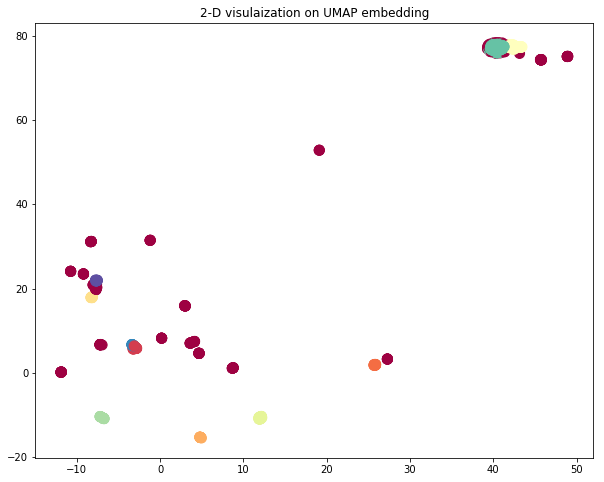

In [357]:
#Plot UMAP result and visulize the 
plt.figure(figsize=(10,8))
plt.scatter(umap_result[:,0],umap_result[:,1],cmap="Spectral",
           c=DBSCAN(eps=0.3,min_samples=20).fit_predict(umap_result),s=100)
plt.title('2-D visulaization on UMAP embedding')
plt.show()

From DBSCAN's result, there are 10 clusters. -1 represents noise.

In [358]:
#Find out how many labels from DBSCAN's result.
dbs =DBSCAN(eps=0.3,min_samples=20).fit_predict(umap_result)
np.unique(dbs)

array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9], dtype=int64)

In [359]:
# Add labels into original dataframe and dummy dataframe
tweet_df['label'] = dbs
hashtags_dummy['label'] = dbs

From original dataframe, i would like to retrieve out the retweet count for every tweet, it now count is there, just replace with zero. Meanwhile, i also drop all records which do not have hashtags due to our following analysis is related to hashtags. 

In [360]:
df = pd.DataFrame(tweets_data)
retweet_count = df['retweeted_status'].apply(lambda x: x['retweet_count']if x is not np.nan else 0)
tweet_df['retweet_count'] = retweet_count
tweet_df.hashtags = tweet_df.hashtags.apply(lambda y: np.nan if len(y)==0 else y)
tweet_df.dropna(inplace=True) 
tweet_df

,username,text,hashtags,created_at,label,retweet_count
0,"{'id': 745891466438975488, 'id_str': '74589146...",Complete #Python #Training: From The Basics Al...,"[Python, Training]",Thu Mar 18 15:12:48 +0000 2021,4,0
1,"{'id': 935446829730291717, 'id_str': '93544682...",RT @BristowColin: How to Collect Metadata with...,"[ArtificialIntelligence, AI, DataScience, 100D...",Thu Mar 18 15:12:50 +0000 2021,0,15
2,"{'id': 402464562, 'id_str': '402464562', 'name...",RT @MathsChemistry: We do \n#Paper pay \n#pyth...,"[Paper, python, homework, Onlineclass, Essaypa...",Thu Mar 18 15:12:53 +0000 2021,1,7
3,"{'id': 1320998551942475781, 'id_str': '1320998...",RT @uhello_world: Follow @uhello_world for mor...,"[programmer, programming, coding, developer, c...",Thu Mar 18 15:12:54 +0000 2021,2,8
4,"{'id': 1147637639924916225, 'id_str': '1147637...",Thinking of starting a tutorial series that ex...,[javascript],Thu Mar 18 15:12:57 +0000 2021,-1,0
5,"{'id': 4019607322, 'id_str': '4019607322', 'na...",RT @Br3Sc: Python tip🐍:\n\nHow to swap two var...,"[developers, node, nodejs, coding]",Thu Mar 18 15:12:59 +0000 2021,-1,18
6,"{'id': 1320998551942475781, 'id_str': '1320998...",RT @uhello_world: Follow @uhello_world for mor...,"[programmer, programming, coding, developer, c...",Thu Mar 18 15:12:59 +0000 2021,2,2
7,"{'id': 1320998551942475781, 'id_str': '1320998...",RT @uhello_world: Follow @uhello_world for mor...,"[programmer, programming, coding, developer, c...",Thu Mar 18 15:13:05 +0000 2021,2,1
8,"{'id': 1295715136141963267, 'id_str': '1295715...",RT @SourabhSKatoch: Best Free GPU alternatives...,"[DEVCommunity, MachineLearning, Python]",Thu Mar 18 15:13:07 +0000 2021,4,32
9,"{'id': 402464562, 'id_str': '402464562', 'name...",RT @Br3Sc: Python tip🐍:\n\nHow to swap two var...,"[developers, node, nodejs, coding]",Thu Mar 18 15:13:10 +0000 2021,-1,19


Due to i am interested to know what kind of topics or event in tweets are most popular, i need to find out how many times of reweets happens in a cluster. 

In [361]:
# Find out retweet counts for each cluster 
retweet_label_sum = pd.DataFrame(tweet_df.groupby('label')['retweet_count'].apply(lambda x : x.astype(float).sum()))
retweet_label_sum = retweet_label_sum.iloc[1:,:]
retweet_label_sum

,retweet_count
label,
0,773.0
1,363.0
2,76.0
3,245.0
4,2429.0
5,550.0
6,1460.0
7,1945.0
8,834.0


From below plot, the cluster 4 has the highest retweet count, the cluster 2 has least. 

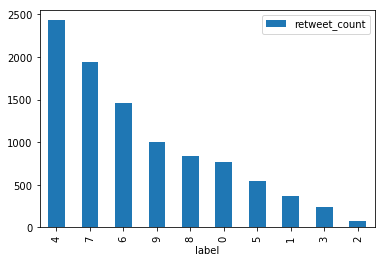

In [362]:
retweet_label_sum.sort_values(by='retweet_count',ascending=False).plot.bar()
plt.show()

In [364]:
# Generate the hashtages count vs cluster
hashtags_label_sum = hashtags_dummy.groupby('label').apply(lambda x : x.astype(float).sum())
hashtags_label_sum = hashtags_label_sum.loc[:,hashtags_top30]
hashtags_label_sum_T = hashtags_label_sum.T
hashtags_label_sum_T = hashtags_label_sum_T.iloc[:,1:]
hashtags_label_sum_T

label,0,1,2,3,4,5,6,7,8,9
python,28.0,31.0,0.0,0.0,141.0,27.0,34.0,0.0,4.0,37.0
machinelearning,8.0,0.0,0.0,20.0,46.0,57.0,0.0,3.0,16.0,37.0
ai,33.0,0.0,0.0,1.0,0.0,57.0,8.0,7.0,16.0,37.0
datascience,33.0,0.0,0.0,1.0,6.0,57.0,26.0,0.0,16.0,0.0
analytics,0.0,0.0,0.0,0.0,0.0,57.0,34.0,0.0,7.0,0.0
100daysofcode,27.0,31.0,0.0,0.0,19.0,0.0,0.0,1.0,15.0,27.0
iot,0.0,0.0,0.0,0.0,2.0,57.0,34.0,0.0,0.0,0.0
bigdata,2.0,0.0,0.0,0.0,0.0,57.0,34.0,1.0,0.0,0.0
iiot,0.0,0.0,0.0,0.0,0.0,41.0,34.0,0.0,0.0,37.0
javascript,0.0,0.0,7.0,1.0,15.0,0.0,0.0,2.0,0.0,0.0


According to plot of hashtags frequency shown below and retweet count plot above, we can link the data from these two plots and read out some info. For example, the hashtags in cluster 4 which has highest retweet counts are mostly 'python', 'machine learning', 'pandas', 'docker', 'flask', '100 days of code', 'javascript'. The most tweets in this cluster seems related to web development and its deployment. People are very responsive on this area's tweet.  In cluster 7, the words are mostly 'ai', 'homework','essay','docker', we may conclude that the tweets in this cluster are mostly from students. They may be doing some homework related to AI area and publish tweets for getting some help, other people may like to retweet them for getting more people to help. 

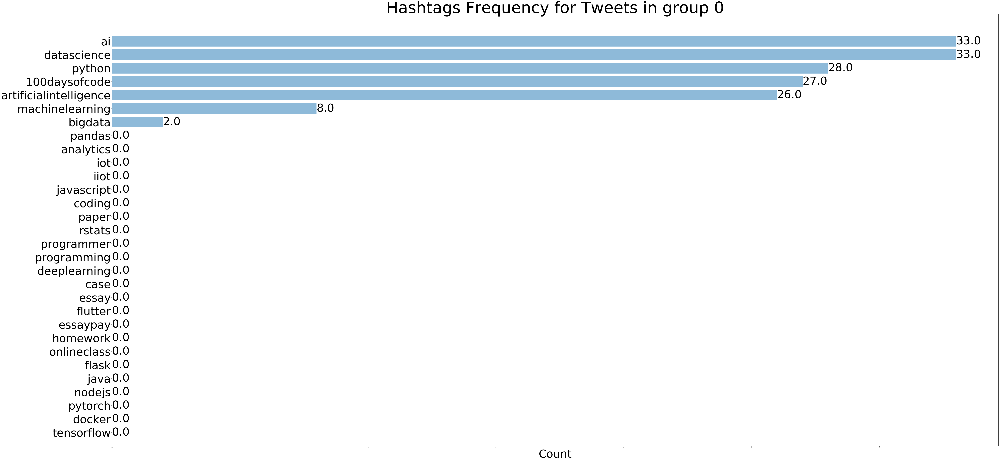

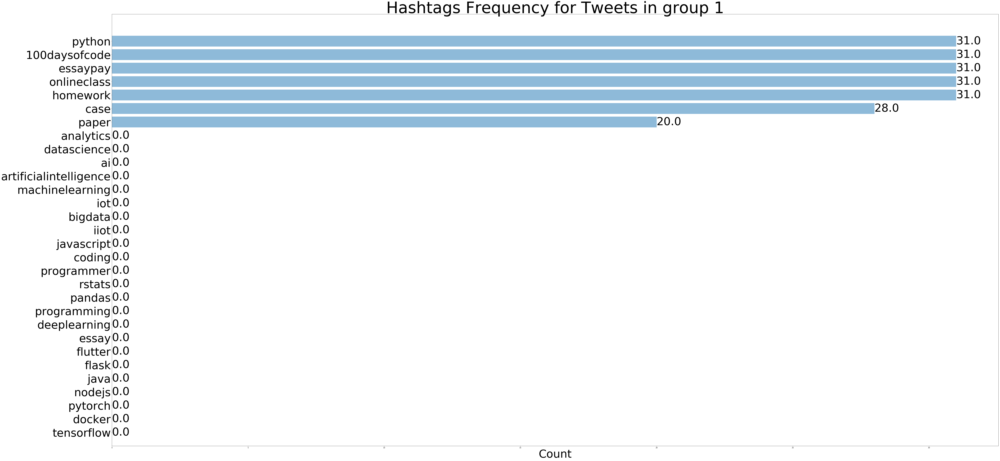

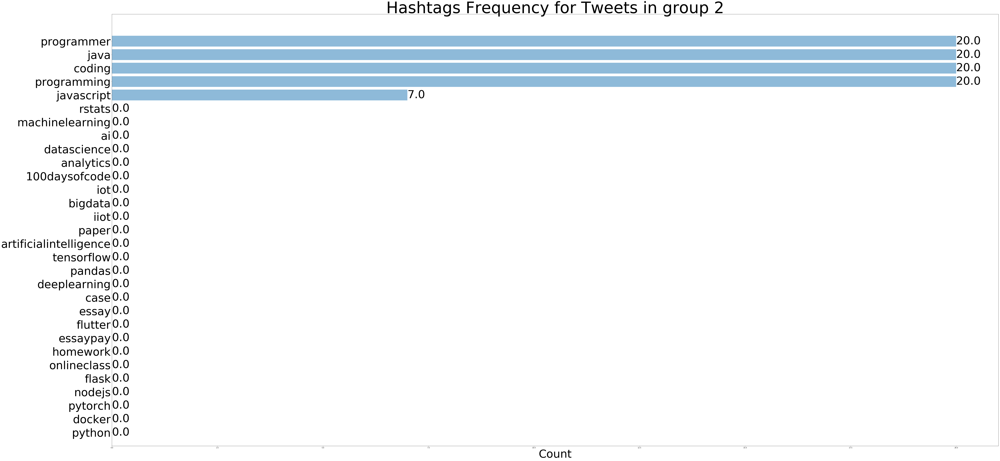

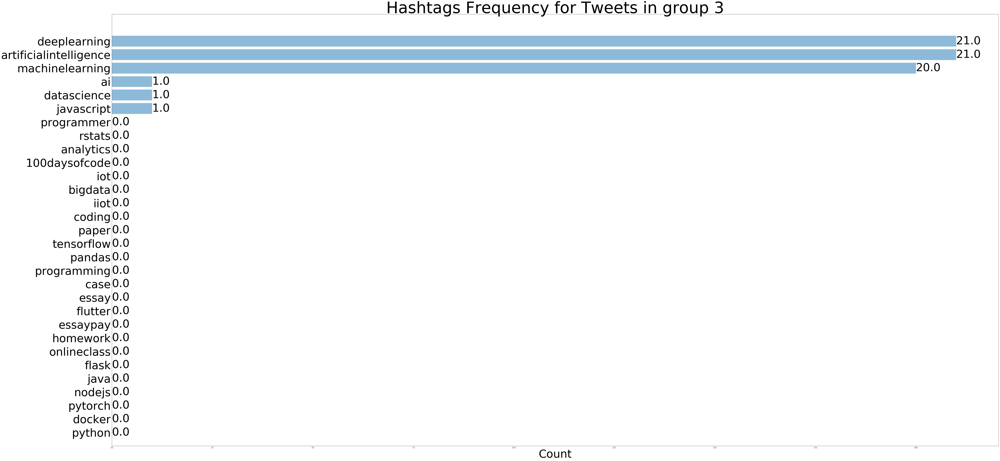

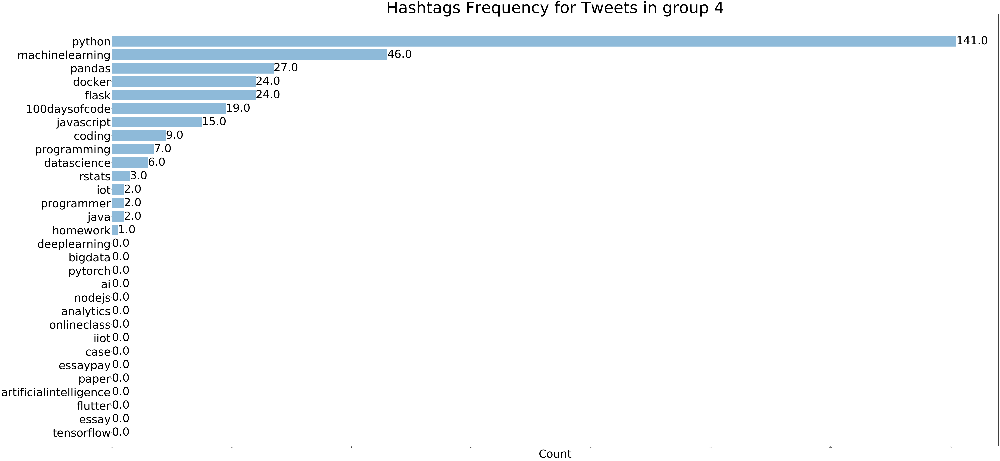

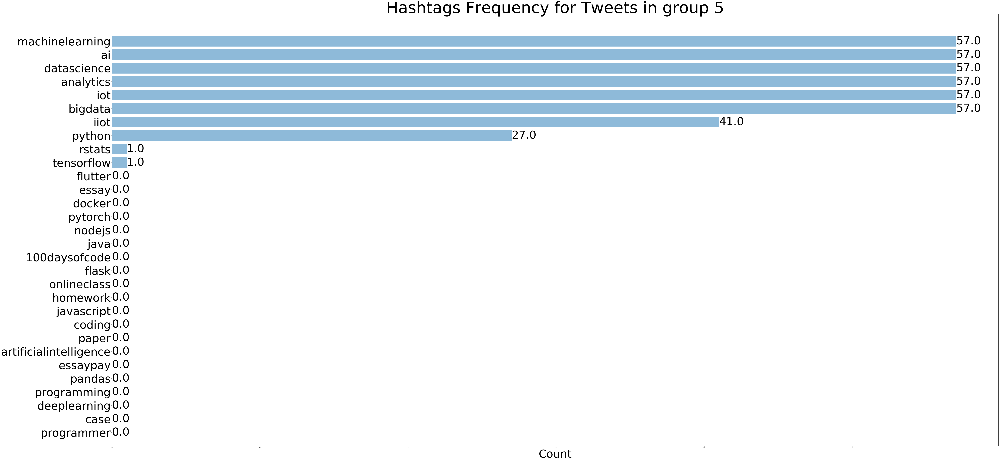

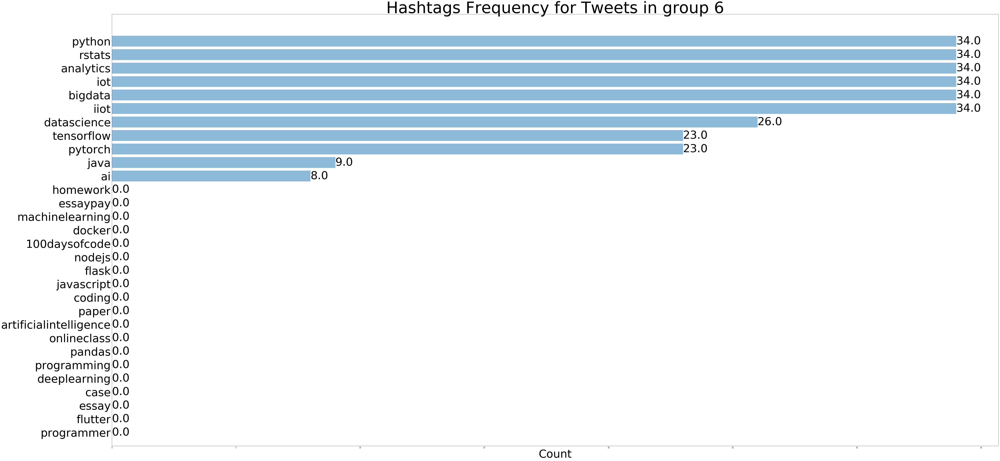

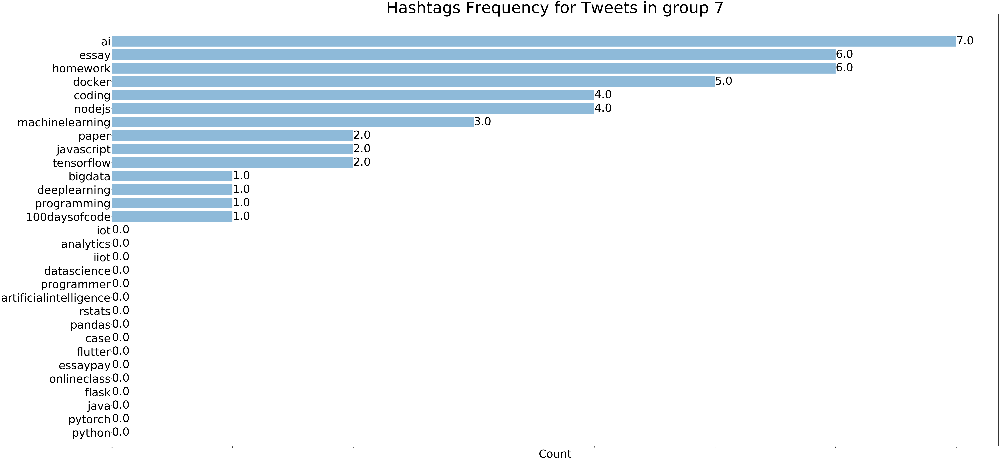

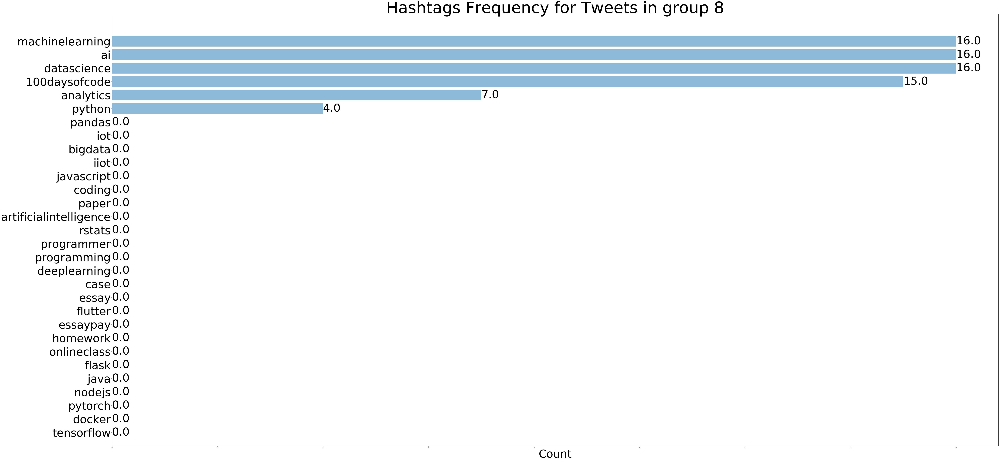

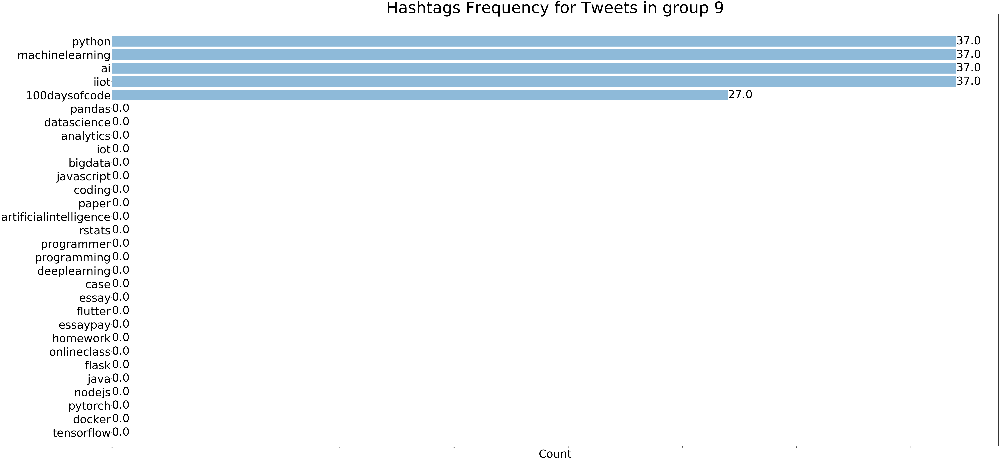

In [365]:
for i in range(hashtags_label_sum_T.shape[1]):
    # Plot frequency of hashtags related to the keywords
    fig, ax = plt.subplots(figsize=(100,len(hashtags_label_sum_T)+20))
    y_pos = np.arange(len(hashtags_label_sum_T))
    plt.barh(y_pos,hashtags_label_sum_T.iloc[:,i].sort_values(ascending=False),align='center', alpha=0.5)
    plt.yticks(y_pos, hashtags_label_sum_T.iloc[:,i].sort_values(ascending=False).index,fontsize=70)
    plt.ylim(-2,len(hashtags_label_sum_T))
    plt.xlabel('Count',fontsize=70)
    plt.title(f'Hashtags Frequency for Tweets in group {i}',fontsize=100)
    plt.gca().invert_yaxis()

    x = hashtags_label_sum_T.iloc[:,i].sort_values(ascending=False)
    for index, value in enumerate(x):
        plt.text(value, index, str(value),fontsize=70,verticalalignment ='center',linespacing=5.3)

    plt.show()

### 4.4 Analysis - Find out which words have most occurance in tweets' text. 

In [334]:
# Create function to remove some fixed pattern like "@..."
def remove_pattern(input_txt, pattern):
    r = re.findall(pattern, input_txt)
    for i in r:
        input_txt = re.sub(i, '', input_txt)
        
    return input_txt 

tweet_df['text'] = np.vectorize(remove_pattern)(tweet_df['text'], "@[\w]*")
tweet_df = df.reset_index(drop=True)
tweet_df

,contributors,coordinates,created_at,display_text_range,entities,extended_entities,extended_tweet,favorite_count,favorited,filter_level,...,quoted_status_permalink,reply_count,retweet_count,retweeted,retweeted_status,source,text,timestamp_ms,truncated,user
0,None,None,Thu Mar 18 15:12:48 +0000 2021,"[0, 140]","{'hashtags': [{'text': 'Python', 'indices': [9...",NaN,{'full_text': 'Complete #Python #Training: Fro...,0,False,low,...,NaN,0,0,False,NaN,"<a href=""https://about.twitter.com/products/tw...",Complete #Python #Training: From The Basics Al...,1616080368301,True,"{'id': 745891466438975488, 'id_str': '74589146..."
1,None,None,Thu Mar 18 15:12:50 +0000 2021,NaN,{'hashtags': [{'text': 'ArtificialIntelligence...,NaN,NaN,0,False,low,...,NaN,0,0,False,{'created_at': 'Thu Mar 18 14:12:04 +0000 2021...,"<a href=""https://mybot.twitter.com"" rel=""nofol...",RT @BristowColin: How to Collect Metadata with...,1616080370905,False,"{'id': 935446829730291717, 'id_str': '93544682..."
2,None,None,Thu Mar 18 15:12:53 +0000 2021,NaN,"{'hashtags': [{'text': 'Paper', 'indices': [27...",NaN,NaN,0,False,low,...,NaN,0,0,False,{'created_at': 'Thu Mar 18 14:54:21 +0000 2021...,,RT @MathsChemistry: We do \n#Paper pay \n#pyth...,1616080373664,False,"{'id': 402464562, 'id_str': '402464562', 'name..."
3,None,None,Thu Mar 18 15:12:54 +0000 2021,NaN,"{'hashtags': [{'text': 'programmer', 'indices'...",NaN,NaN,0,False,low,...,NaN,0,0,False,{'created_at': 'Thu Mar 18 14:56:50 +0000 2021...,,RT @uhello_world: Follow @uhello_world for mor...,1616080374350,False,"{'id': 1320998551942475781, 'id_str': '1320998..."
4,None,None,Thu Mar 18 15:12:57 +0000 2021,NaN,"{'hashtags': [{'text': 'javascript', 'indices'...",NaN,{'full_text': 'Thinking of starting a tutorial...,0,False,low,...,NaN,0,0,False,NaN,"<a href=""https://mobile.twitter.com"" rel=""nofo...",Thinking of starting a tutorial series that ex...,1616080377525,True,"{'id': 1147637639924916225, 'id_str': '1147637..."
5,None,None,Thu Mar 18 15:12:59 +0000 2021,NaN,"{'hashtags': [{'text': 'developers', 'indices'...",NaN,NaN,0,False,low,...,NaN,0,0,False,{'created_at': 'Thu Mar 18 14:00:01 +0000 2021...,"<a href=""http://twitter.com/download/android"" ...",RT @Br3Sc: Python tip🐍:\n\nHow to swap two var...,1616080379788,False,"{'id': 4019607322, 'id_str': '4019607322', 'na..."
6,None,None,Thu Mar 18 15:12:59 +0000 2021,NaN,"{'hashtags': [{'text': 'programmer', 'indices'...",NaN,NaN,0,False,low,...,NaN,0,0,False,{'created_at': 'Thu Mar 18 14:56:13 +0000 2021...,,RT @uhello_world: Follow @uhello_world for mor...,1616080379840,False,"{'id': 1320998551942475781, 'id_str': '1320998..."
7,None,None,Thu Mar 18 15:13:05 +0000 2021,NaN,"{'hashtags': [{'text': 'programmer', 'indices'...",NaN,NaN,0,False,low,...,NaN,0,0,False,{'created_at': 'Thu Mar 18 14:55:53 +0000 2021...,,RT @uhello_world: Follow @uhello_world for mor...,1616080385334,False,"{'id': 1320998551942475781, 'id_str': '1320998..."
8,None,None,Thu Mar 18 15:13:07 +0000 2021,NaN,"{'hashtags': [{'text': 'DEVCommunity', 'indice...",NaN,NaN,0,False,low,...,NaN,0,0,False,{'created_at': 'Thu Mar 18 08:41:00 +0000 2021...,,RT @SourabhSKatoch: Best Free GPU alternatives...,1616080387972,False,"{'id': 1295715136141963267, 'id_str': '1295715..."
9,None,None,Thu Mar 18 15:13:10 +0000 2021,NaN,"{'hashtags': [{'text': 'developers', 'indices'...",NaN,NaN,0,False,low,...,NaN,0,0,False,{'created_at': 'Thu Mar 18 14:00:01 +0000 2021...,,RT @Br3Sc: Python tip🐍:\n\nHow to swap two var...,1616080390056,False,"{'id': 402464562, 'id_str': '402464562', 'name..."


The tweet's text still contain something like url adddress, we need to clean it. 

In [335]:
#Cleaning Tweets
corpus = []
for i in range(0, len(tweet_df)):
    tweet = re.sub('[^a-zA-Z0-9]', ' ', tweet_df['text'][i])
    tweet = tweet.lower()
    tweet = re.sub('rt', '', tweet)
    tweet = re.sub('http', '', tweet)
    tweet = re.sub('https', '', tweet)
    tweet = re.sub('co', '', tweet)
    tweet = tweet.split()
    ps = PorterStemmer()
    tweet = [ps.stem(word) for word in tweet if not word in set(stopwords.words('english'))]
    tweet = ' '.join(tweet)
    corpus.append(tweet)
    
corpus

['mplete python train basic way creat app game learner receiv av 99rrj11xwa',
 'bristowlin llect metadata sa inform catalog aificialintellig ai datasci 100daysofd python',
 'mathschemistri paper pay python homework onlineclass essaypay 100daysofd enometr assignmentdu math homework ess',
 'uhello world follow uhello world programm program ding develop de der programmingoffici meme java',
 'think sta tutori seri explain ml super simpl mostli visual term javascript rusxhl9ka1',
 'br3sc python tip swap two variabl wrong right way check develop node nodej ding vue',
 'uhello world follow uhello world programm program ding develop de der programmingoffici meme java',
 'uhello world follow uhello world programm program ding develop de der programmingoffici meme java',
 'sourabhskatoch best free gpu altern googl lab 2021 vxiaiwag4f devmmun machinelearn python',
 'br3sc python tip swap two variabl wrong right way check develop node nodej ding vue',
 'uhello world follow uhello world programm pr

From the word cloud I plot, those words like big data, AI, python, iot, machine learning having most occurence in tweets. It represents that the tweets related to keyword 'python' which are also related to those most popular area in nowadays, like big data, AI, IOT,data science. It means that pyhton is a very important tool in this areas. 

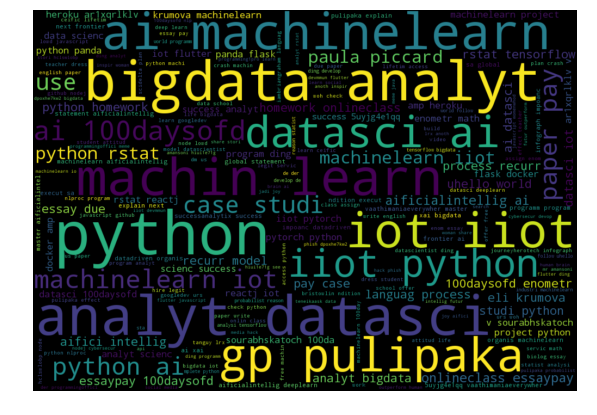

In [337]:
#Word Cloud
all_words = ' '.join([text for text in corpus])
wordcloud = WordCloud(width=1000, height=700, random_state=21, max_font_size=110).generate(all_words)
plt.figure(figsize=(10, 7))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis('off')
plt.show()